# Machine Learning and Predictive Analytics
### Final Project - Machine Generated Abstract Art
#### Group 1
- Amro Shanshal
- Yue Wu
- Rose Ro
- Arpit Parihar

****

#### Model 4 - GANsformer
****

### Setup

**Mounting Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


**Switching to TensorFlow version 1.x**

In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


**Importing Libraries**

In [ ]:
from matplotlib import pyplot as plt
import os
from os import listdir
from PIL import Image
import sys
import glob

**Cloning Model Repository**

In [ ]:
%cd '/content/gdrive/Shareddrives/Deep Learning - GANsformer'
! git clone 'https://github.com/dorarad/gansformer.git'
%cd 'gansformer'
! git pull

/content/gdrive/Shareddrives/Deep Learning - GANsformer
fatal: destination path 'gansformer' already exists and is not an empty directory.
/content/gdrive/Shareddrives/Deep Learning - GANsformer/gansformer
Already up to date.


### Model Demo

**Generating Sample Images From Pre-Trained Models**

In [ ]:
model = {'bed': 'gdrive:bedrooms-snapshot.pkl',
         'clevr': 'gdrive:clevr-snapshot.pkl',
         'city': 'gdrive:cityscapes-snapshot.pkl',
         'ffhq': 'gdrive:ffhq-snapshot.pkl'}
out_dir = '/content/gdrive/Shareddrives/Deep Learning - GANsformer/images'

r, c = (10, 10)
!python generate.py --gpus 0 --model={model['ffhq']} --output-dir {out_dir.replace(' ', '\ ')} --images-num={r * c}

**Printing Images**

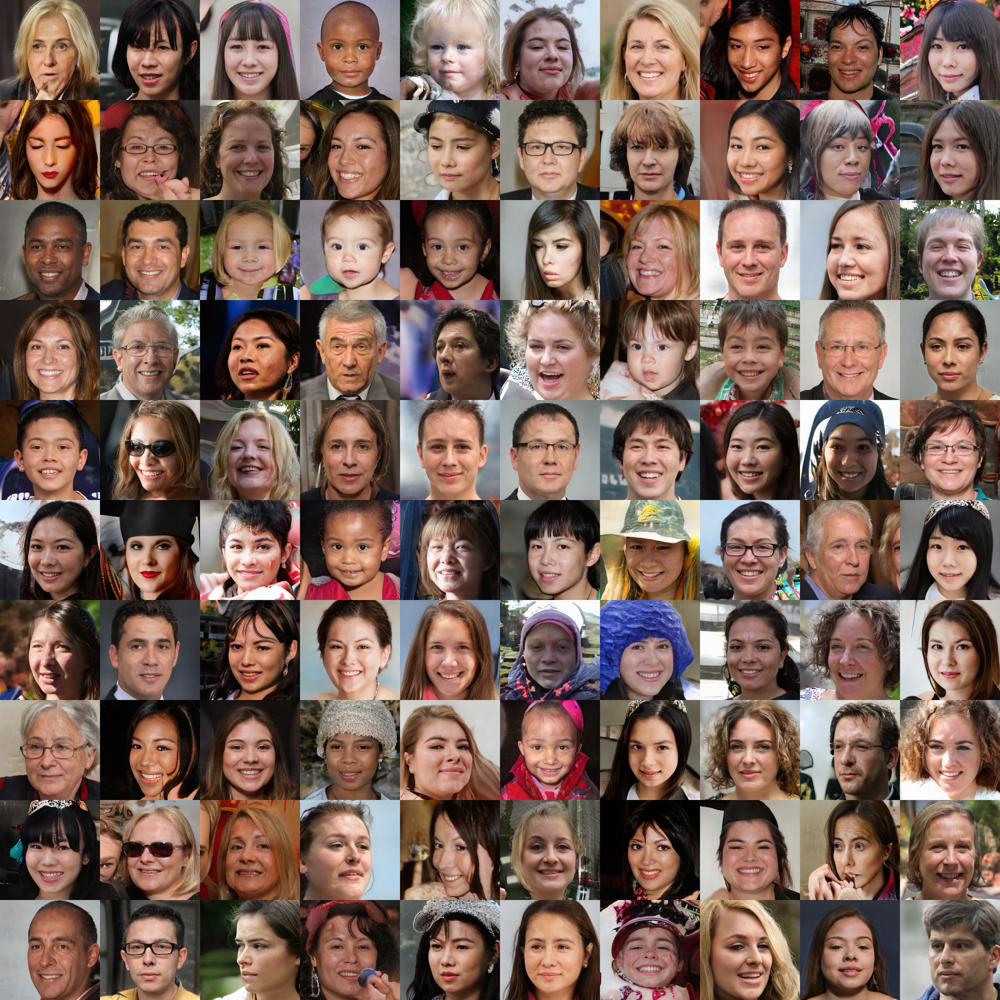

In [ ]:
dim = 256
files = glob.glob(os.path.join(out_dir, '*.png'))
images = [Image.open(x) for x in files]
new_im = Image.new('RGB', (dim * r, dim * c))

for i, im in enumerate(images):
  new_im.paste(im, (dim * (i % r), dim * (i // c)))
new_im

### Data Preparation

**Standardizing and Resizing Images**

In [ ]:
data_path = '/content/gdrive/Shareddrives/Deep Learning - GANsformer/GAN Training Data/Abstract_gallery/'
output_path = '/content/gdrive/Shareddrives/Deep Learning - GANsformer/GAN Training Data/Abstract_gallery_256/'

In [ ]:
imagesList = listdir(data_path)
for image in imagesList:
    img = Image.open(data_path + image)
    new_img = img.resize((128, 128))
    new_img.save(output_path + image, 'JPEG', optimize=True)

**Creating TFRecords File**

In [ ]:
!python prepare_data.py --task 'abstract-train' --images-dir {output_path} --format jpg --ratio 1 --max-images 2782

### Model Training

**Checking Training Script Parameters**

In [ ]:
!python run_network.py -h

usage: run_network.py [-h] [--expname EXPNAME] [--eval] [--train]
                      [--gpus GPUS] [--gansformer-default]
                      [--baseline {GAN,StyleGAN2,kGAN,SAGAN}]
                      [--pretrained-pkl PRETRAINED_PKL] [--restart] [--reload]
                      [--recompile] [--last-snapshots LAST_SNAPSHOTS]
                      [--data-dir DIR] --dataset DATASET [--ratio RATIO]
                      [--resolution RESOLUTION] [--num-threads NUM_THREADS]
                      [--mirror-augment] [--train-images-num TRAIN_IMAGES_NUM]
                      [--batch-size BATCH_SIZE]
                      [--minibatch-size MINIBATCH_SIZE] [--total-kimg KIMG]
                      [--gamma GAMMA] [--clip CLIP] [--g-lr G_LR]
                      [--d-lr D_LR] [--result-dir DIR] [--metrics METRICS]
                      [--summarize [BOOL]] [--truncation-psi TRUNCATION_PSI]
                      [--keep-samples [BOOL]]
                      [--eval-images-num EVAL_IM

**Fitting The Model**

In [ ]:
model_path = '/content/gdrive/Shareddrives/Deep\ Learning\ -\ GANsformer/gansformer/results/abstract-train-000/network-snapshot-000600.pkl'

!python run_network.py --train --gpus 0 --gansformer-default --expname abstract-train --dataset abstract \
  --pretrained-pkl={model_path} --eval-images-num 1000 --total-kimg 1000 --last-snapshots 5 --metrics None

Resuming abstract-train-000, from /content/gdrive/Shareddrives/Deep Learning - GANsformer/gansformer/results/abstract-train-000/network-snapshot-000600.pkl, kimg 600
Local submit - run_dir: results/abstract-train-000
dnnlib: Running training.training_loop.training_loop() on localhost...
Streaming data using training.dataset.TFRecordDataset datasets...
Dataset shape:  [3, 256, 256]
Dynamic range:  [0, 255]
Constructing networks...
Setting up TensorFlow plugin 'fused_bias_act.cu': Loading... Done.
Setting up TensorFlow plugin 'upfirdn_2d.cu': Loading... Done.
Loading networks from /content/gdrive/Shareddrives/Deep Learning - GANsformer/gansformer/results/abstract-train-000/network-snapshot-000600.pkl...
Copying nets...

G                                            Params    OutputShape         WeightShape     
---                                          ---       ---                 ---             
ltnt_emb/emb                                 512       (16, 32)            (16, 32)     

### Model Results

**Generating and Plotting Output Images**

In [ ]:
model = '/content/gdrive/Shareddrives/Deep Learning - GANsformer/gansformer/results/abstract-train-000/network-final.pkl'
out_dir = '/content/gdrive/Shareddrives/Deep Learning - GANsformer/images_out'
r, c = (10, 10)

!python generate.py --gpus 0 --model={model.replace(' ', '\ ')} --output-dir={out_dir.replace(' ', '\ ')} --images-num={r * c}

Loading networks...
Setting up TensorFlow plugin 'fused_bias_act.cu': Loading... Done.
Setting up TensorFlow plugin 'upfirdn_2d.cu': Loading... Done.

Gs                                           Params    OutputShape         WeightShape     
---                                          ---       ---                 ---             
ltnt_emb/emb                                 512       (16, 32)            (16, 32)        
G_mapping/AttLayer_0                         6336      (?, 32)             -               
G_mapping/Dense0_0                           1056      (?, 32)             (32, 32)        
G_mapping/Dense0_1                           1056      (?, 32)             (32, 32)        
G_mapping/AttLayer_1                         6336      (?, 32)             -               
G_mapping/Dense1_0                           1056      (?, 32)             (32, 32)        
G_mapping/Dense1_1                           1056      (?, 32)             (32, 32)        
G_mapping/AttLayer_2 

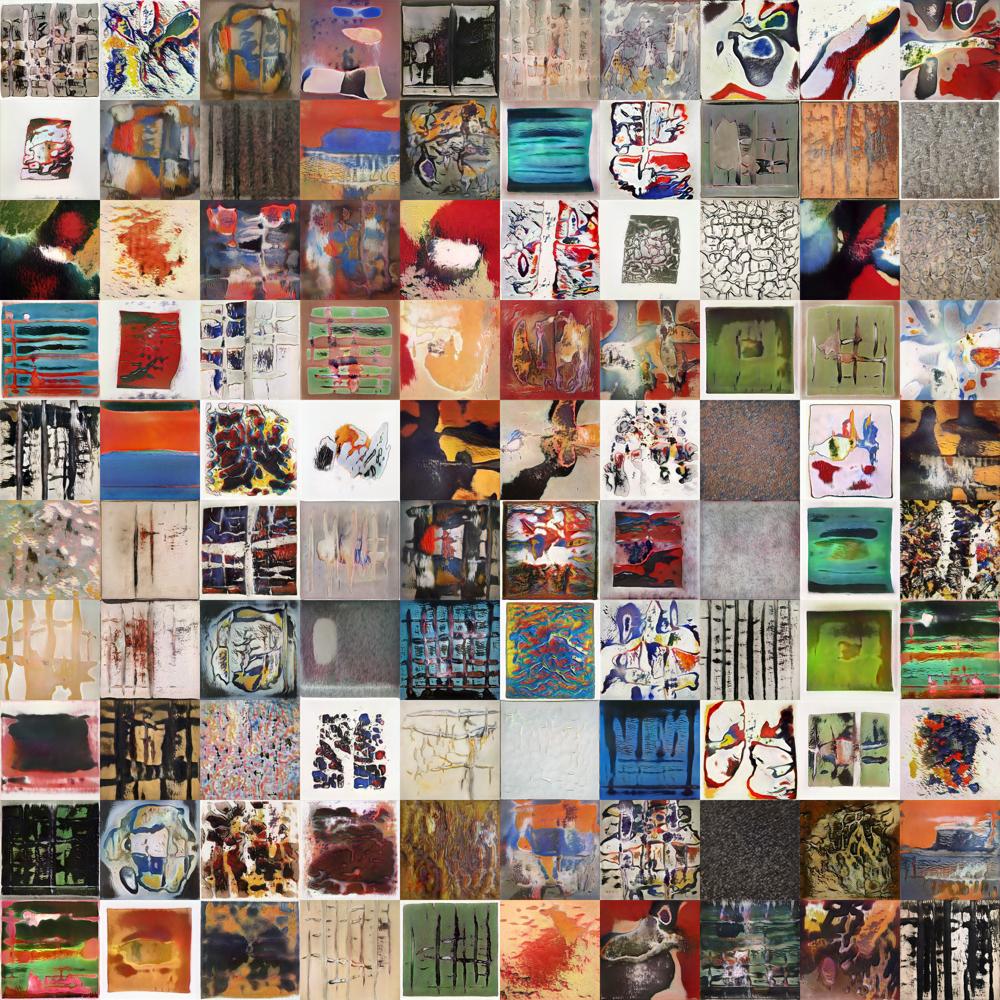

In [ ]:
dim = 256
files = glob.glob(os.path.join(out_dir, '*.png'))
images = [Image.open(x) for x in files]
new_im = Image.new('RGB', (dim * r, dim * c))

for i, im in enumerate(images):
  new_im.paste(im, (dim * (i % r), dim * (i // c)))
new_im

### Model Evaluation

**FID Scores**

In [ ]:
!python run_network.py --eval --gpus 0 --expname abstract-train --dataset abstract

Resuming abstract-train-000, from results/abstract-train-000/network-snapshot-001000.pkl, kimg 1000
Local submit - run_dir: results/abstract-train-000
dnnlib: Running training.training_loop.training_loop() on localhost...
Streaming data using training.dataset.TFRecordDataset datasets...
Dataset shape:  [3, 256, 256]
Dynamic range:  [0, 255]
Loading networks from results/abstract-train-000/network-snapshot-001000.pkl...
Setting up TensorFlow plugin 'fused_bias_act.cu': Loading... Done.
Setting up TensorFlow plugin 'upfirdn_2d.cu': Loading... Done.

G                                            Params    OutputShape         WeightShape     
---                                          ---       ---                 ---             
ltnt_emb/emb                                 512       (16, 32)            (16, 32)        
G_mapping/AttLayer_0                         6336      (?, 32)             -               
G_mapping/Dense0_0                           1056      (?, 32)             (32